In [1]:
#!for a in /sys/bus/pci/devices/*; do echo 0 | sudo tee -a $a/numa_node; done
import tensorflow as tf
import matplotlib.pyplot as plt
import os
from data_processing import dataset
from models import model
from utils import tools
from plots import plots, edge_detection_plots

os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'

2023-02-05 00:14:47.024028: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-02-05 00:14:47.114532: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-02-05 00:14:47.136996: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-02-05 00:14:47.542501: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; 

In [2]:
config_directory = 'lenet'

config_path = os.path.join(os.getcwd(), 'configs', config_directory)
DataProcessing = dataset.DataProcessing(config_path=config_path)
Model = model.Model(config_path)
tools.parser(Model.cfg, DataProcessing.cfg)
Model.load_data(DataProcessing.cfg["NAME"])
DataProcessing.load_dataset_information()

2023-02-05 00:14:48.658188: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-05 00:14:48.665047: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-05 00:14:48.665220: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-05 00:14:48.665994: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the approp

# Load Dataset, Preprocess Images and Dataset

The TRAIN DS contains 1500 images.
The TEST DS contains 300 images.
The REAL_WORLD DS contains 41 images.


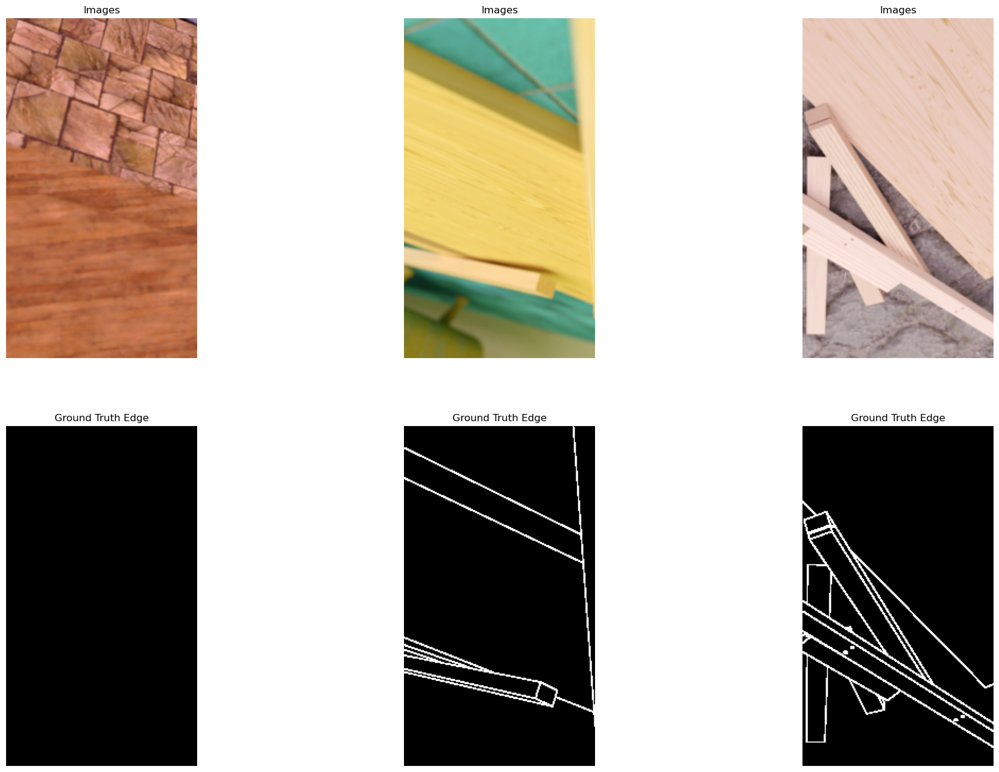

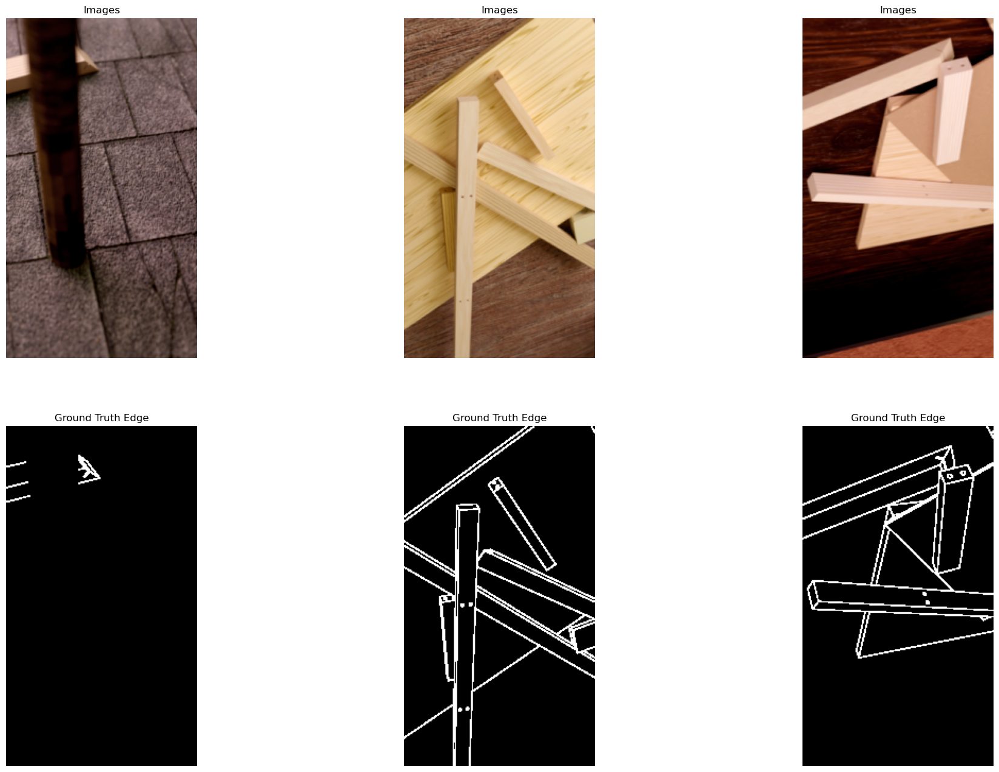

In [3]:
if Model.train_model:
    train_ds, img_count_train = DataProcessing.load_dataset(DataProcessing.key.train)
test_ds, img_count_test = DataProcessing.load_dataset(DataProcessing.key.test)

real_world_ds, img_count_real_world_ds = DataProcessing.load_dataset(DataProcessing.key.real_world)

if Model.train_model:
    for inp, out in train_ds.take(2):
        edge_detection_plots.plot_edges(images=inp['in_img'], labels_edge=out['out_edge'],
                                        batch_size=DataProcessing.cfg['TEST']['BATCH_SIZE'])

# Define, Compile and Train Model

In [4]:
if Model.train_model:
    model = Model.get_neural_network_model(DataProcessing.input_data_cfg, DataProcessing.output_data_cfg)
    # model.summary()

    lr = Model.get_lr(img_count_train, DataProcessing.cfg['TRAIN']['BATCH_SIZE'])
    model.compile(optimizer=tf.keras.optimizers.Adam(lr),
                  loss=Model.get_loss_function(DataProcessing.output_data_cfg),
                  metrics=Model.get_metrics(DataProcessing.output_data_cfg))

    history = model.fit(train_ds, epochs=Model.cfg["EPOCHS"], validation_data=train_ds,
                        callbacks=Model.get_callbacks(), verbose=1)

model = Model.get_best_model_from_checkpoints()

Epoch 1/100


2023-02-05 00:15:00.394562: I tensorflow/stream_executor/cuda/cuda_blas.cc:1614] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.
2023-02-05 00:15:00.876000: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8100


500/500 [==============================] - 27s 44ms/step - loss: 3404.4912 - out_edge_loss: 3404.4912 - accuracy: 0.9264 - accuracy_edge_1: 0.9264 - f1_edge: 0.4585 - precision_edge: 0.4588 - recall_edge: 0.4616 - f1_edge_1: 0.4585 - precision_edge_1: 0.4588 - recall_edge_1: 0.4616 - val_loss: 3946.4346 - val_out_edge_loss: 3946.4346 - val_accuracy: 0.9070 - val_accuracy_edge_1: 0.9070 - val_f1_edge: 0.5020 - val_precision_edge: 0.3894 - val_recall_edge: 0.7062 - val_f1_edge_1: 0.5020 - val_precision_edge_1: 0.3894 - val_recall_edge_1: 0.7062
Epoch 2/100
500/500 [==============================] - 22s 43ms/step - loss: 2593.5969 - out_edge_loss: 2593.5969 - accuracy: 0.9532 - accuracy_edge_1: 0.9532 - f1_edge: 0.6601 - precision_edge: 0.6334 - recall_edge: 0.6894 - f1_edge_1: 0.6601 - precision_edge_1: 0.6334 - recall_edge_1: 0.6894 - val_loss: 4342.6270 - val_out_edge_loss: 4342.6270 - val_accuracy: 0.8477 - val_accuracy_edge_1: 0.8477 - val_f1_edge: 0.4249 - val_precision_edge: 0.2836

Epoch 16/100
500/500 [==============================] - 22s 43ms/step - loss: 1674.1298 - out_edge_loss: 1674.1298 - accuracy: 0.9760 - accuracy_edge_1: 0.9760 - f1_edge: 0.8222 - precision_edge: 0.8112 - recall_edge: 0.8336 - f1_edge_1: 0.8222 - precision_edge_1: 0.8112 - recall_edge_1: 0.8336 - val_loss: 2063.4839 - val_out_edge_loss: 2063.4839 - val_accuracy: 0.9719 - val_accuracy_edge_1: 0.9719 - val_f1_edge: 0.7711 - val_precision_edge: 0.8414 - val_recall_edge: 0.7116 - val_f1_edge_1: 0.7711 - val_precision_edge_1: 0.8414 - val_recall_edge_1: 0.7116
Epoch 17/100
500/500 [==============================] - 22s 45ms/step - loss: 1644.4062 - out_edge_loss: 1644.4062 - accuracy: 0.9770 - accuracy_edge_1: 0.9770 - f1_edge: 0.8290 - precision_edge: 0.8213 - recall_edge: 0.8370 - f1_edge_1: 0.8290 - precision_edge_1: 0.8213 - recall_edge_1: 0.8370 - val_loss: 1781.1730 - val_out_edge_loss: 1781.1730 - val_accuracy: 0.9749 - val_accuracy_edge_1: 0.9749 - val_f1_edge: 0.8164 - val_precisio

INFO:tensorflow:Assets written to: /home/david/SemesterProject/Models/edge_detection/lenet/CKPT/ckpt-loss=1831.91-epoch=20.00-f1=0.8144/assets


INFO:tensorflow:Assets written to: /home/david/SemesterProject/Models/edge_detection/lenet/CKPT/ckpt-loss=1831.91-epoch=20.00-f1=0.8144/assets


500/500 [==============================] - 28s 56ms/step - loss: 1600.5687 - out_edge_loss: 1600.5687 - accuracy: 0.9772 - accuracy_edge_1: 0.9772 - f1_edge: 0.8332 - precision_edge: 0.8228 - recall_edge: 0.8440 - f1_edge_1: 0.8332 - precision_edge_1: 0.8228 - recall_edge_1: 0.8440 - val_loss: 1831.9061 - val_out_edge_loss: 1831.9061 - val_accuracy: 0.9770 - val_accuracy_edge_1: 0.9770 - val_f1_edge: 0.8144 - val_precision_edge: 0.8761 - val_recall_edge: 0.7608 - val_f1_edge_1: 0.8144 - val_precision_edge_1: 0.8761 - val_recall_edge_1: 0.7608
Epoch 21/100
500/500 [==============================] - 22s 44ms/step - loss: 1577.0865 - out_edge_loss: 1577.0865 - accuracy: 0.9794 - accuracy_edge_1: 0.9794 - f1_edge: 0.8439 - precision_edge: 0.8406 - recall_edge: 0.8473 - f1_edge_1: 0.8439 - precision_edge_1: 0.8406 - recall_edge_1: 0.8473 - val_loss: 1756.5015 - val_out_edge_loss: 1756.5015 - val_accuracy: 0.9704 - val_accuracy_edge_1: 0.9704 - val_f1_edge: 0.7977 - val_precision_edge: 0.729

Epoch 35/100
500/500 [==============================] - 22s 44ms/step - loss: 1452.7467 - out_edge_loss: 1452.7467 - accuracy: 0.9810 - accuracy_edge_1: 0.9810 - f1_edge: 0.8569 - precision_edge: 0.8489 - recall_edge: 0.8653 - f1_edge_1: 0.8569 - precision_edge_1: 0.8489 - recall_edge_1: 0.8653 - val_loss: 1468.6222 - val_out_edge_loss: 1468.6222 - val_accuracy: 0.9820 - val_accuracy_edge_1: 0.9820 - val_f1_edge: 0.8603 - val_precision_edge: 0.8860 - val_recall_edge: 0.8361 - val_f1_edge_1: 0.8603 - val_precision_edge_1: 0.8860 - val_recall_edge_1: 0.8361
Epoch 36/100
500/500 [==============================] - 22s 45ms/step - loss: 1451.1521 - out_edge_loss: 1451.1521 - accuracy: 0.9810 - accuracy_edge_1: 0.9810 - f1_edge: 0.8570 - precision_edge: 0.8522 - recall_edge: 0.8618 - f1_edge_1: 0.8570 - precision_edge_1: 0.8522 - recall_edge_1: 0.8618 - val_loss: 1531.5496 - val_out_edge_loss: 1531.5496 - val_accuracy: 0.9803 - val_accuracy_edge_1: 0.9803 - val_f1_edge: 0.8471 - val_precisio

INFO:tensorflow:Assets written to: /home/david/SemesterProject/Models/edge_detection/lenet/CKPT/ckpt-loss=1595.89-epoch=40.00-f1=0.8403/assets


INFO:tensorflow:Assets written to: /home/david/SemesterProject/Models/edge_detection/lenet/CKPT/ckpt-loss=1595.89-epoch=40.00-f1=0.8403/assets


500/500 [==============================] - 31s 63ms/step - loss: 1415.9258 - out_edge_loss: 1415.9258 - accuracy: 0.9827 - accuracy_edge_1: 0.9827 - f1_edge: 0.8708 - precision_edge: 0.8690 - recall_edge: 0.8727 - f1_edge_1: 0.8708 - precision_edge_1: 0.8690 - recall_edge_1: 0.8727 - val_loss: 1595.8871 - val_out_edge_loss: 1595.8871 - val_accuracy: 0.9793 - val_accuracy_edge_1: 0.9793 - val_f1_edge: 0.8403 - val_precision_edge: 0.8619 - val_recall_edge: 0.8198 - val_f1_edge_1: 0.8403 - val_precision_edge_1: 0.8619 - val_recall_edge_1: 0.8198
Epoch 41/100
500/500 [==============================] - 22s 44ms/step - loss: 1417.0018 - out_edge_loss: 1417.0018 - accuracy: 0.9828 - accuracy_edge_1: 0.9828 - f1_edge: 0.8692 - precision_edge: 0.8686 - recall_edge: 0.8698 - f1_edge_1: 0.8692 - precision_edge_1: 0.8686 - recall_edge_1: 0.8698 - val_loss: 1546.8994 - val_out_edge_loss: 1546.8994 - val_accuracy: 0.9807 - val_accuracy_edge_1: 0.9807 - val_f1_edge: 0.8546 - val_precision_edge: 0.855

Epoch 55/100
500/500 [==============================] - 21s 42ms/step - loss: 1351.9954 - out_edge_loss: 1351.9954 - accuracy: 0.9838 - accuracy_edge_1: 0.9838 - f1_edge: 0.8789 - precision_edge: 0.8790 - recall_edge: 0.8788 - f1_edge_1: 0.8789 - precision_edge_1: 0.8790 - recall_edge_1: 0.8788 - val_loss: 1504.0809 - val_out_edge_loss: 1504.0809 - val_accuracy: 0.9830 - val_accuracy_edge_1: 0.9830 - val_f1_edge: 0.8632 - val_precision_edge: 0.9246 - val_recall_edge: 0.8094 - val_f1_edge_1: 0.8632 - val_precision_edge_1: 0.9246 - val_recall_edge_1: 0.8094
Epoch 56/100
500/500 [==============================] - 21s 43ms/step - loss: 1351.1534 - out_edge_loss: 1351.1534 - accuracy: 0.9840 - accuracy_edge_1: 0.9840 - f1_edge: 0.8763 - precision_edge: 0.8760 - recall_edge: 0.8766 - f1_edge_1: 0.8763 - precision_edge_1: 0.8760 - recall_edge_1: 0.8766 - val_loss: 1350.1385 - val_out_edge_loss: 1350.1385 - val_accuracy: 0.9845 - val_accuracy_edge_1: 0.9845 - val_f1_edge: 0.8798 - val_precisio

INFO:tensorflow:Assets written to: /home/david/SemesterProject/Models/edge_detection/lenet/CKPT/ckpt-loss=1386.22-epoch=60.00-f1=0.8852/assets


INFO:tensorflow:Assets written to: /home/david/SemesterProject/Models/edge_detection/lenet/CKPT/ckpt-loss=1386.22-epoch=60.00-f1=0.8852/assets


500/500 [==============================] - 28s 55ms/step - loss: 1335.0367 - out_edge_loss: 1335.0367 - accuracy: 0.9837 - accuracy_edge_1: 0.9837 - f1_edge: 0.8791 - precision_edge: 0.8792 - recall_edge: 0.8791 - f1_edge_1: 0.8791 - precision_edge_1: 0.8792 - recall_edge_1: 0.8791 - val_loss: 1386.2217 - val_out_edge_loss: 1386.2217 - val_accuracy: 0.9854 - val_accuracy_edge_1: 0.9854 - val_f1_edge: 0.8852 - val_precision_edge: 0.9236 - val_recall_edge: 0.8498 - val_f1_edge_1: 0.8852 - val_precision_edge_1: 0.9236 - val_recall_edge_1: 0.8498
Epoch 61/100
500/500 [==============================] - 22s 45ms/step - loss: 1324.1049 - out_edge_loss: 1324.1049 - accuracy: 0.9843 - accuracy_edge_1: 0.9843 - f1_edge: 0.8820 - precision_edge: 0.8820 - recall_edge: 0.8821 - f1_edge_1: 0.8820 - precision_edge_1: 0.8820 - recall_edge_1: 0.8821 - val_loss: 1343.4578 - val_out_edge_loss: 1343.4578 - val_accuracy: 0.9854 - val_accuracy_edge_1: 0.9854 - val_f1_edge: 0.8862 - val_precision_edge: 0.918

Epoch 75/100
500/500 [==============================] - 22s 43ms/step - loss: 1283.0151 - out_edge_loss: 1283.0151 - accuracy: 0.9853 - accuracy_edge_1: 0.9853 - f1_edge: 0.8895 - precision_edge: 0.8926 - recall_edge: 0.8865 - f1_edge_1: 0.8895 - precision_edge_1: 0.8926 - recall_edge_1: 0.8865 - val_loss: 1405.7360 - val_out_edge_loss: 1405.7360 - val_accuracy: 0.9849 - val_accuracy_edge_1: 0.9849 - val_f1_edge: 0.8792 - val_precision_edge: 0.9370 - val_recall_edge: 0.8281 - val_f1_edge_1: 0.8792 - val_precision_edge_1: 0.9370 - val_recall_edge_1: 0.8281
Epoch 76/100
500/500 [==============================] - 21s 42ms/step - loss: 1284.2645 - out_edge_loss: 1284.2645 - accuracy: 0.9850 - accuracy_edge_1: 0.9850 - f1_edge: 0.8869 - precision_edge: 0.8881 - recall_edge: 0.8857 - f1_edge_1: 0.8869 - precision_edge_1: 0.8881 - recall_edge_1: 0.8857 - val_loss: 1427.5414 - val_out_edge_loss: 1427.5414 - val_accuracy: 0.9836 - val_accuracy_edge_1: 0.9836 - val_f1_edge: 0.8664 - val_precisio

INFO:tensorflow:Assets written to: /home/david/SemesterProject/Models/edge_detection/lenet/CKPT/ckpt-loss=1486.67-epoch=80.00-f1=0.8601/assets


INFO:tensorflow:Assets written to: /home/david/SemesterProject/Models/edge_detection/lenet/CKPT/ckpt-loss=1486.67-epoch=80.00-f1=0.8601/assets


500/500 [==============================] - 28s 57ms/step - loss: 1266.5527 - out_edge_loss: 1266.5527 - accuracy: 0.9859 - accuracy_edge_1: 0.9859 - f1_edge: 0.8915 - precision_edge: 0.8937 - recall_edge: 0.8893 - f1_edge_1: 0.8915 - precision_edge_1: 0.8937 - recall_edge_1: 0.8893 - val_loss: 1486.6658 - val_out_edge_loss: 1486.6658 - val_accuracy: 0.9830 - val_accuracy_edge_1: 0.9830 - val_f1_edge: 0.8601 - val_precision_edge: 0.9480 - val_recall_edge: 0.7871 - val_f1_edge_1: 0.8601 - val_precision_edge_1: 0.9480 - val_recall_edge_1: 0.7871
Epoch 81/100
500/500 [==============================] - 21s 42ms/step - loss: 1257.5309 - out_edge_loss: 1257.5309 - accuracy: 0.9861 - accuracy_edge_1: 0.9861 - f1_edge: 0.8945 - precision_edge: 0.8986 - recall_edge: 0.8905 - f1_edge_1: 0.8945 - precision_edge_1: 0.8986 - recall_edge_1: 0.8905 - val_loss: 1315.9940 - val_out_edge_loss: 1315.9940 - val_accuracy: 0.9852 - val_accuracy_edge_1: 0.9852 - val_f1_edge: 0.8848 - val_precision_edge: 0.917

Epoch 95/100
500/500 [==============================] - 22s 45ms/step - loss: 1233.5149 - out_edge_loss: 1233.5149 - accuracy: 0.9860 - accuracy_edge_1: 0.9860 - f1_edge: 0.8942 - precision_edge: 0.8959 - recall_edge: 0.8926 - f1_edge_1: 0.8942 - precision_edge_1: 0.8959 - recall_edge_1: 0.8926 - val_loss: 1244.7922 - val_out_edge_loss: 1244.7922 - val_accuracy: 0.9866 - val_accuracy_edge_1: 0.9866 - val_f1_edge: 0.8953 - val_precision_edge: 0.9286 - val_recall_edge: 0.8643 - val_f1_edge_1: 0.8953 - val_precision_edge_1: 0.9286 - val_recall_edge_1: 0.8643
Epoch 96/100
500/500 [==============================] - 22s 45ms/step - loss: 1220.3077 - out_edge_loss: 1220.3077 - accuracy: 0.9863 - accuracy_edge_1: 0.9863 - f1_edge: 0.8956 - precision_edge: 0.8982 - recall_edge: 0.8930 - f1_edge_1: 0.8956 - precision_edge_1: 0.8982 - recall_edge_1: 0.8930 - val_loss: 1255.6877 - val_out_edge_loss: 1255.6877 - val_accuracy: 0.9865 - val_accuracy_edge_1: 0.9865 - val_f1_edge: 0.8942 - val_precisio

INFO:tensorflow:Assets written to: /home/david/SemesterProject/Models/edge_detection/lenet/CKPT/ckpt-loss=1223.55-epoch=100.00-f1=0.8988/assets


INFO:tensorflow:Assets written to: /home/david/SemesterProject/Models/edge_detection/lenet/CKPT/ckpt-loss=1223.55-epoch=100.00-f1=0.8988/assets


500/500 [==============================] - 32s 63ms/step - loss: 1213.0072 - out_edge_loss: 1213.0072 - accuracy: 0.9863 - accuracy_edge_1: 0.9863 - f1_edge: 0.8954 - precision_edge: 0.8973 - recall_edge: 0.8939 - f1_edge_1: 0.8954 - precision_edge_1: 0.8973 - recall_edge_1: 0.8939 - val_loss: 1223.5494 - val_out_edge_loss: 1223.5494 - val_accuracy: 0.9870 - val_accuracy_edge_1: 0.9870 - val_f1_edge: 0.8988 - val_precision_edge: 0.9321 - val_recall_edge: 0.8678 - val_f1_edge_1: 0.8988 - val_precision_edge_1: 0.9321 - val_recall_edge_1: 0.8678
/home/david/SemesterProject/Models/edge_detection/lenet/CKPT/ckpt-loss=1223.55-epoch=100.00-f1=0.8988


INFO:tensorflow:Assets written to: /home/david/SemesterProject/Models/edge_detection/lenet/assets


INFO:tensorflow:Assets written to: /home/david/SemesterProject/Models/edge_detection/lenet/assets


INFO:tensorflow:Assets written to: /home/david/SemesterProject/Models/edge_detection/lenet/TFLITE/assets


INFO:tensorflow:Assets written to: /home/david/SemesterProject/Models/edge_detection/lenet/TFLITE/assets


In [5]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 in_img (InputLayer)            [(None, 320, 180, 3  0           []                               
                                )]                                                                
                                                                                                  
 separable_conv2d (SeparableCon  (None, 160, 90, 30)  147        ['in_img[0][0]']                 
 v2D)                                                                                             
                                                                                                  
 conv2d (Conv2D)                (None, 160, 90, 90)  2790        ['separable_conv2d[0][0]']       
                                                                                              

                                                                                                  
 conv2d_7 (Conv2D)              (None, 80, 45, 20)   820         ['re_lu_7[0][0]']                
                                                                                                  
 batch_normalization_11 (BatchN  (None, 80, 45, 20)  80          ['conv2d_7[0][0]']               
 ormalization)                                                                                    
                                                                                                  
 separable_conv2d_1 (SeparableC  (None, 80, 45, 20)  600         ['batch_normalization_11[0][0]'] 
 onv2D)                                                                                           
                                                                                                  
 batch_normalization_12 (BatchN  (None, 80, 45, 20)  80          ['separable_conv2d_1[0][0]']     
 ormalizat

                                                                                                  
 re_lu_12 (ReLU)                (None, 80, 45, 20)   0           ['batch_normalization_16[0][0]'] 
                                                                                                  
 tf.image.resize (TFOpLambda)   (None, 80, 45, 10)   0           ['re_lu_15[0][0]']               
                                                                                                  
 tf.image.resize_1 (TFOpLambda)  (None, 80, 45, 10)  0           ['re_lu_18[0][0]']               
                                                                                                  
 tf.image.resize_2 (TFOpLambda)  (None, 80, 45, 10)  0           ['re_lu_20[0][0]']               
                                                                                                  
 concatenate (Concatenate)      (None, 80, 45, 50)   0           ['re_lu_12[0][0]',               
          

                                                                                                  
 concatenate_1 (Concatenate)    (None, 160, 90, 11)  0           ['re_lu_26[0][0]',               
                                                                  're_lu_11[0][0]']               
                                                                                                  
 conv2d_18 (Conv2D)             (None, 160, 90, 15)  180         ['concatenate_1[0][0]']          
                                                                                                  
 batch_normalization_32 (BatchN  (None, 160, 90, 15)  60         ['conv2d_18[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 re_lu_27 (ReLU)                (None, 160, 90, 15)  0           ['batch_normalization_32[0][0]'] 
          

# Plot Results

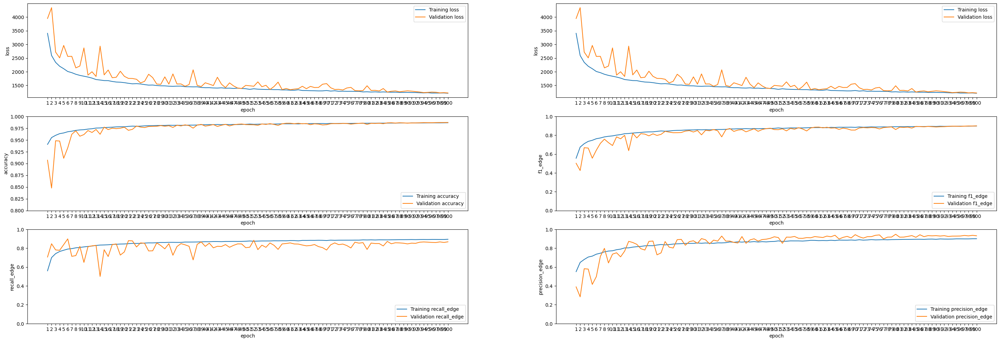

In [6]:
if Model.train_model:
    plot_losses = ["loss", "loss"]
    plot_metrics = ["accuracy", "f1_edge", "recall_edge", "precision_edge"]

    path = os.path.join(Model.Data.paths["FIGURES"], "training")

    plots.plot_training_history(history=history.history, list_of_loss_names=plot_losses,
                                list_of_metric_names=plot_metrics,
                                save=Model.cfg["SAVE"], path=path)

1/1 [==============================] - 0s 430ms/step


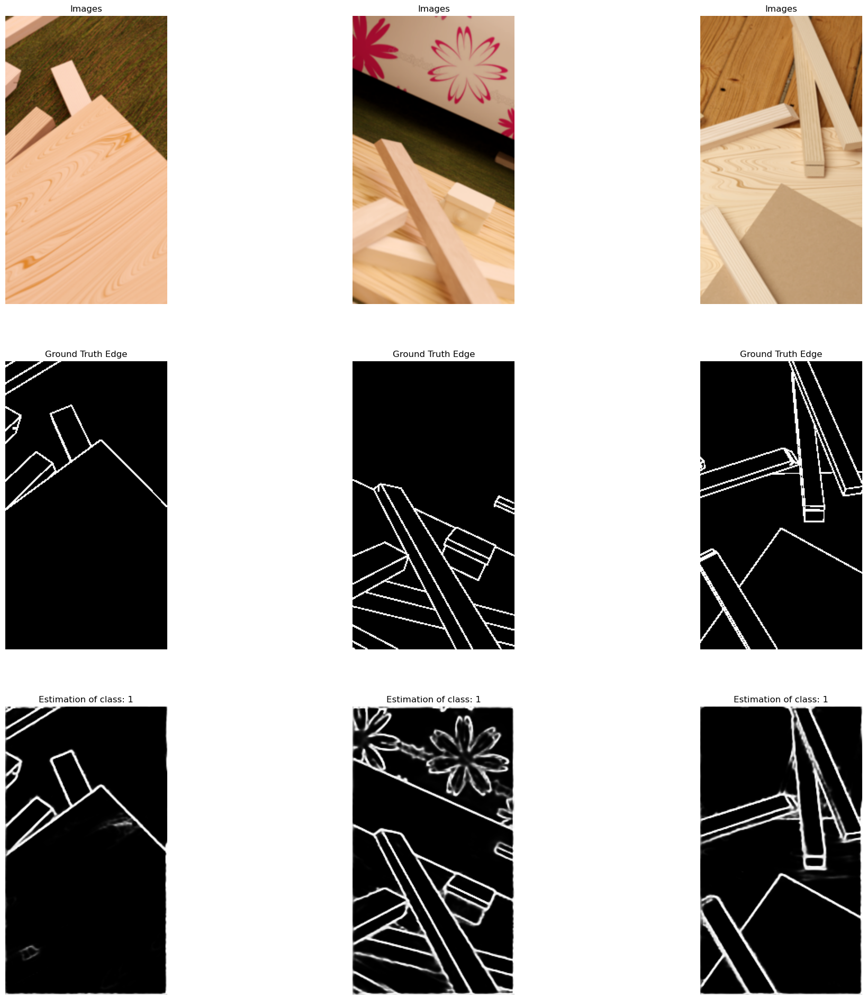

1/1 [==============================] - 0s 21ms/step


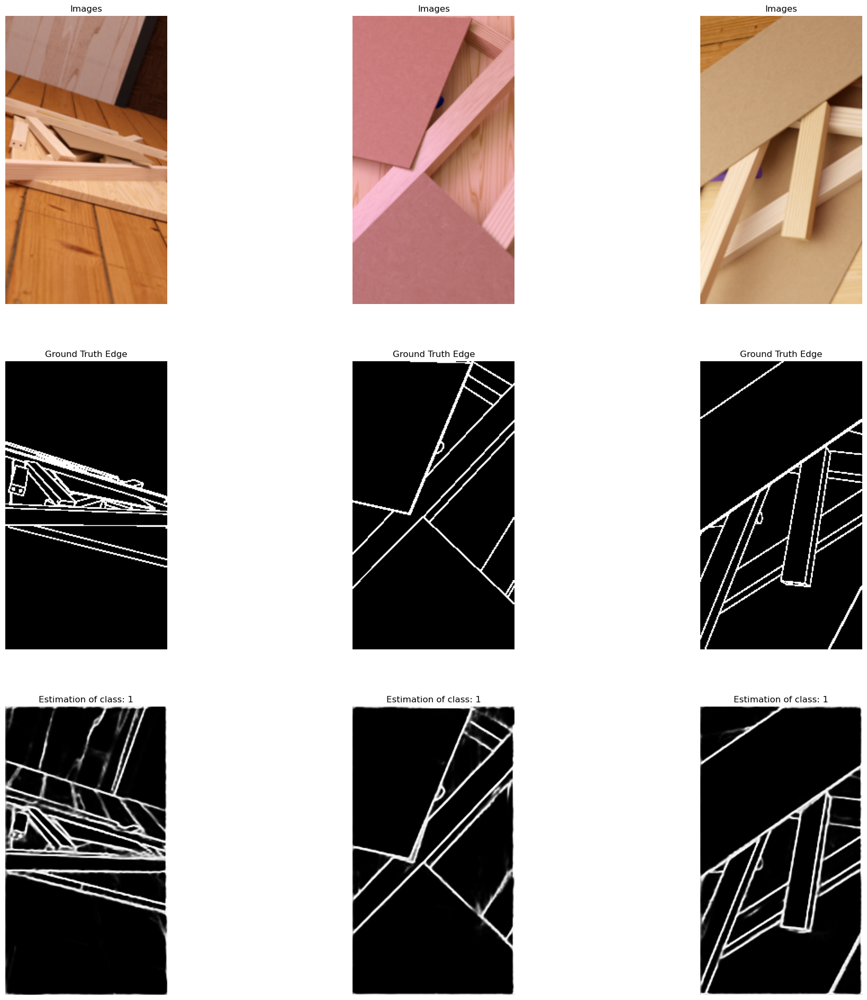

1/1 [==============================] - 0s 26ms/step


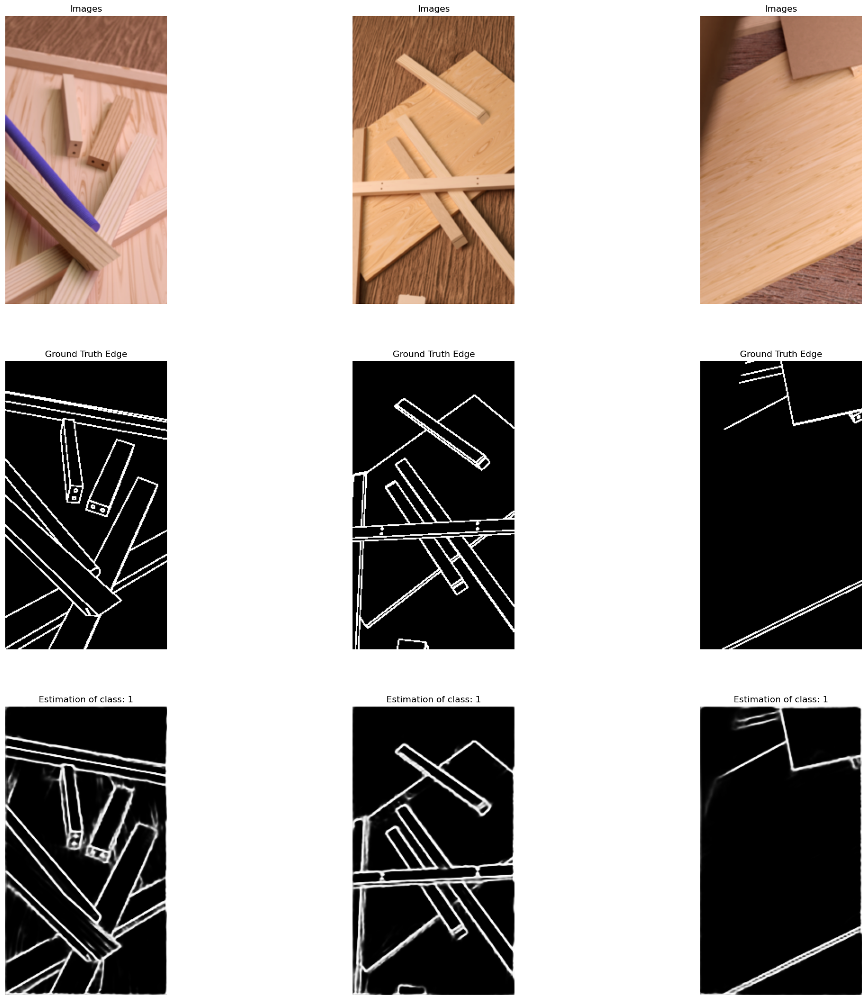

2023-02-05 00:53:31.159624: W tensorflow/core/kernels/data/cache_dataset_ops.cc:856] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


In [7]:
i = 0
for inp, out in test_ds.take(3):
    pred = model.predict(inp)
    path = os.path.join(Model.Data.paths["FIGURES"], "sd_prediction_{}".format(i))
    edge_detection_plots.plot_edges(images=inp['in_img'],
                                    labels_edge=out['out_edge'],
                                    predictions_edge=pred[0],
                                    batch_size=DataProcessing.cfg['TEST']['BATCH_SIZE'],
                                   save=Model.cfg["SAVE"], path=path)
    i += 1

1/1 [==============================] - 0s 116ms/step


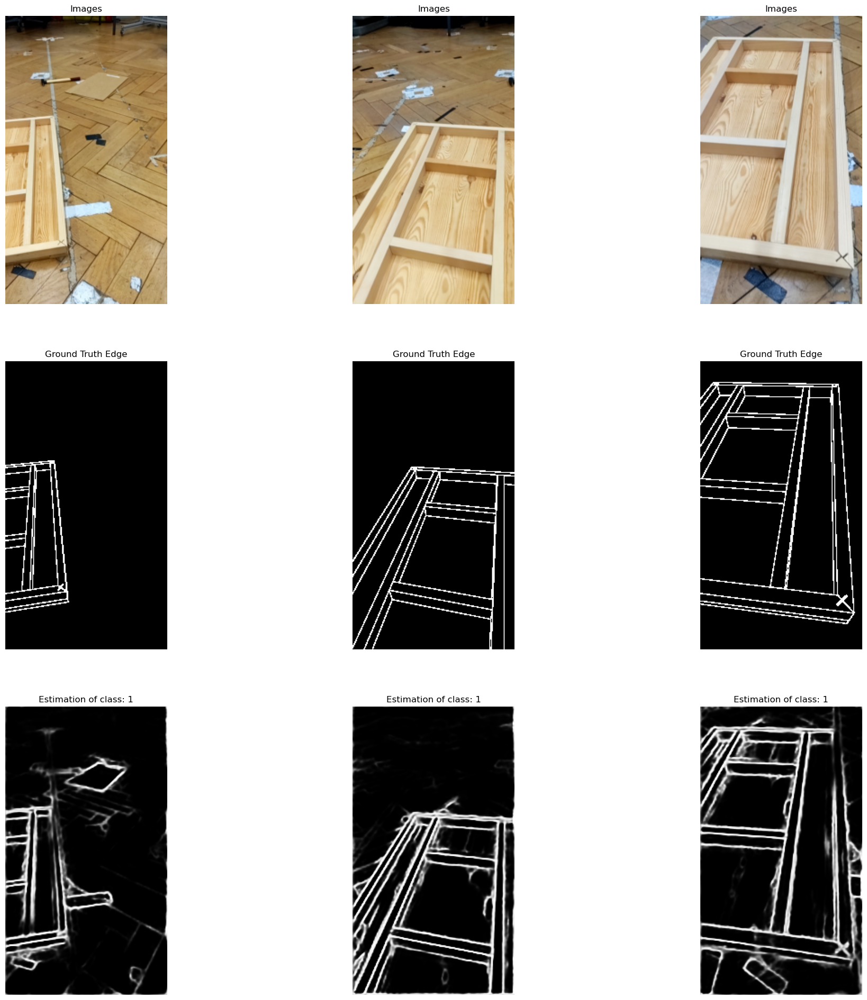

1/1 [==============================] - 0s 27ms/step


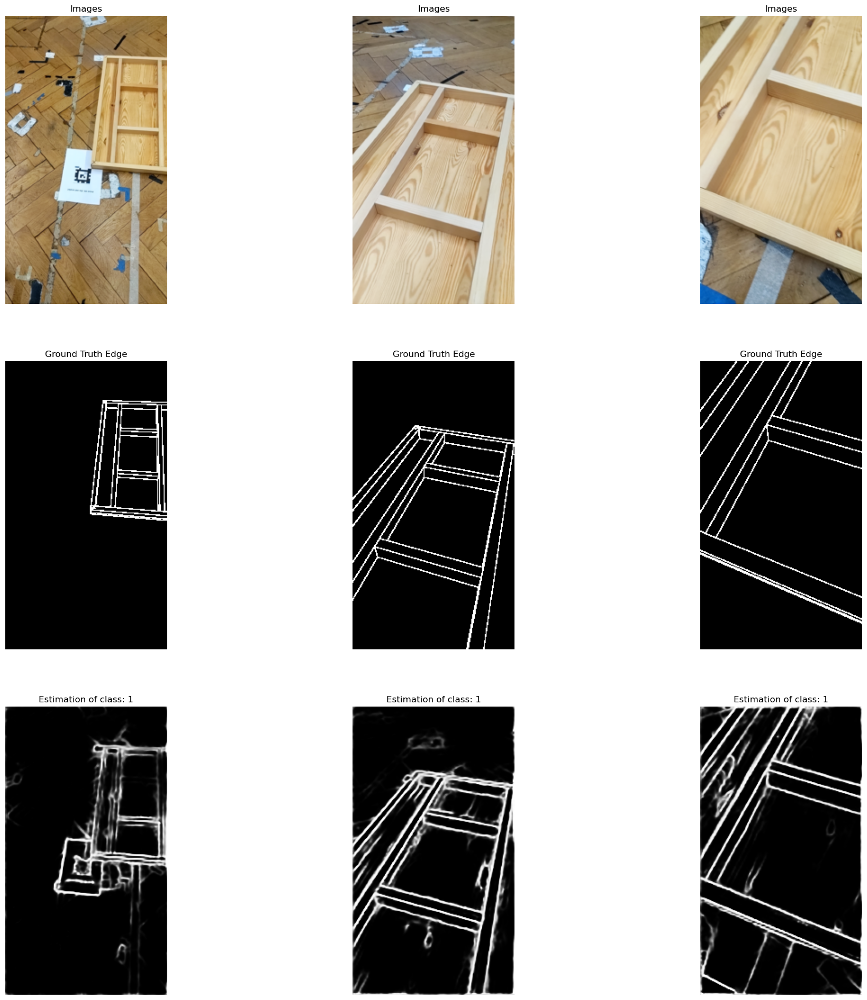

1/1 [==============================] - 0s 23ms/step


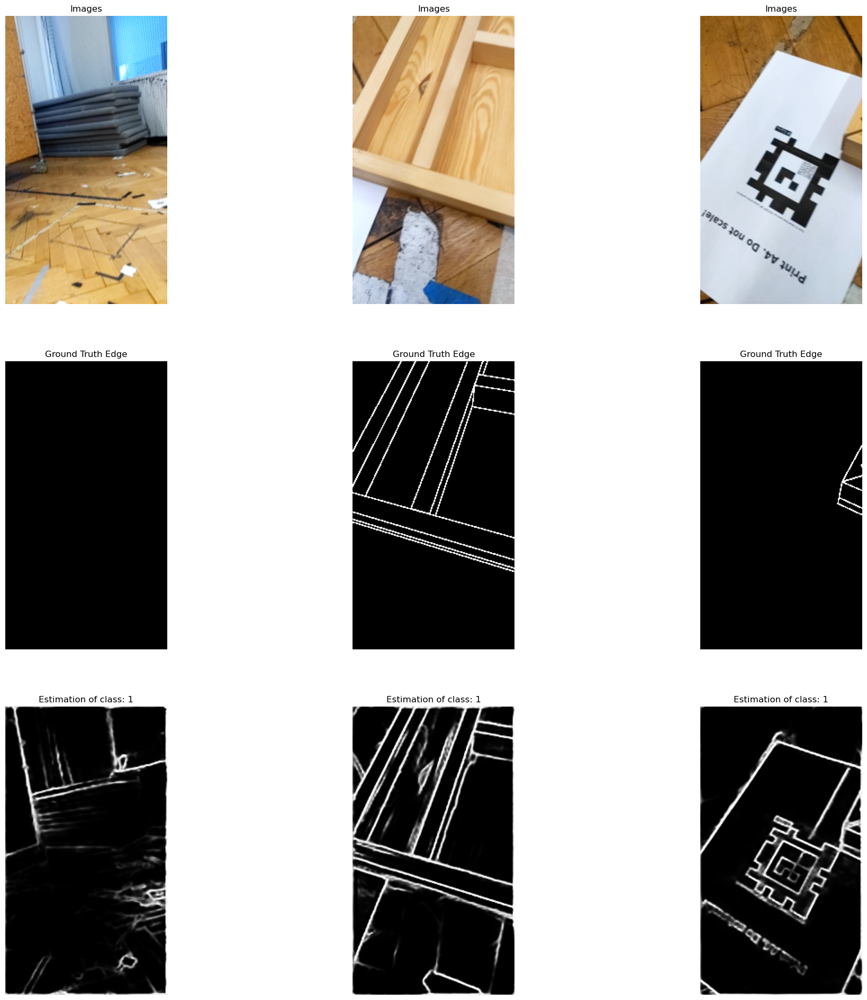

2023-02-05 00:53:36.627938: W tensorflow/core/kernels/data/cache_dataset_ops.cc:856] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


In [8]:
i = 0
for inp, out in real_world_ds.take(3):
    pred = model.predict(inp)
    path = os.path.join(Model.Data.paths["FIGURES"], "rwd_prediction_{}".format(i))
    edge_detection_plots.plot_edges(images=inp['in_img'],
                                    labels_edge=out['out_edge'],
                                    predictions_edge=pred[0],
                                    batch_size=DataProcessing.cfg['TEST']['BATCH_SIZE'],
                                   save=Model.cfg["SAVE"], path=path)
    i += 1

1/1 [==============================] - 0s 23ms/step


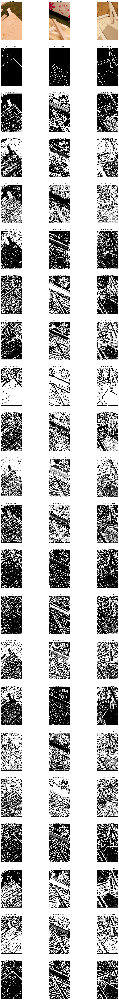

1/1 [==============================] - 0s 23ms/step


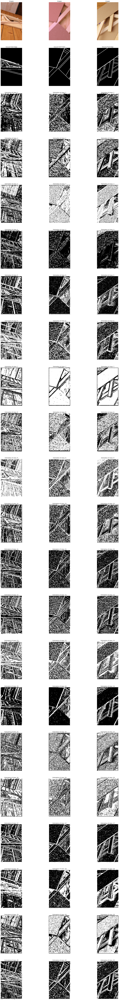

1/1 [==============================] - 0s 23ms/step


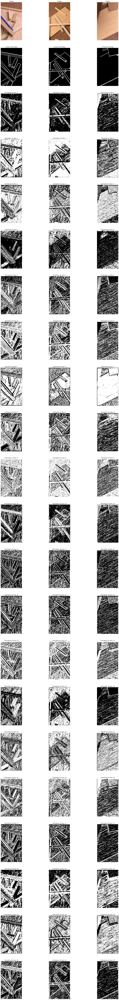

2023-02-05 00:53:53.577417: W tensorflow/core/kernels/data/cache_dataset_ops.cc:856] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


In [9]:
i = 0
for inp, out in test_ds.take(3):
    pred = model.predict(inp)
    path = os.path.join(Model.Data.paths["FIGURES"], "backbone_out_1_{}".format(i))
    edge_detection_plots.plot_edges(images=inp['in_img'],
                                    labels_edge=out['out_edge'],
                                    predictions_edge=pred[1],
                                    batch_size=DataProcessing.cfg['TEST']['BATCH_SIZE'],
                                   save=Model.cfg["SAVE"], path=path)
    i += 1

1/1 [==============================] - 0s 28ms/step


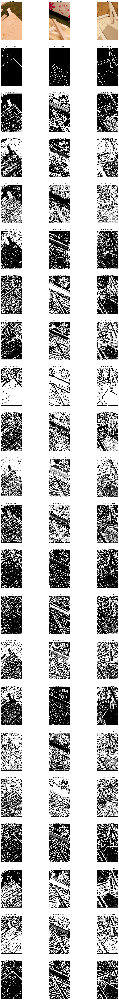

1/1 [==============================] - 0s 24ms/step


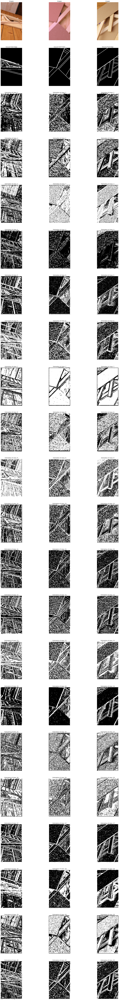

1/1 [==============================] - 0s 26ms/step


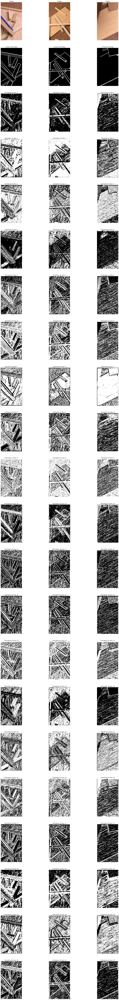

2023-02-05 00:54:13.747898: W tensorflow/core/kernels/data/cache_dataset_ops.cc:856] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


In [10]:
i = 0
for inp, out in test_ds.take(3):
    pred = model.predict(inp)
    path = os.path.join(Model.Data.paths["FIGURES"], "backbone_out_2_{}".format(i))
    edge_detection_plots.plot_edges(images=inp['in_img'],
                                    labels_edge=out['out_edge'],
                                    predictions_edge=pred[2],
                                    batch_size=DataProcessing.cfg['TEST']['BATCH_SIZE'],
                                   save=Model.cfg["SAVE"], path=path)
    i += 1

1/1 [==============================] - 0s 30ms/step


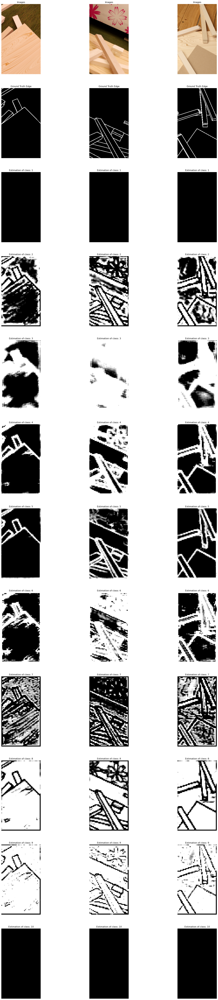

1/1 [==============================] - 0s 31ms/step


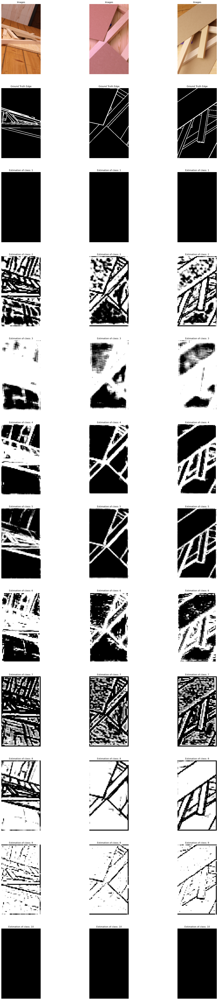

1/1 [==============================] - 0s 24ms/step


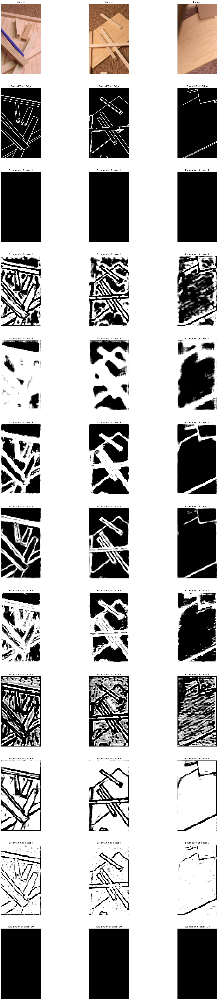

2023-02-05 00:54:26.164452: W tensorflow/core/kernels/data/cache_dataset_ops.cc:856] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


In [11]:
i = 0
for inp, out in test_ds.take(3):
    pred = model.predict(inp)
    path = os.path.join(Model.Data.paths["FIGURES"], "pyramid_out_{}".format(i))
    edge_detection_plots.plot_edges(images=inp['in_img'],
                                    labels_edge=out['out_edge'],
                                    predictions_edge=pred[3],
                                    batch_size=DataProcessing.cfg['TEST']['BATCH_SIZE'],
                                   save=Model.cfg["SAVE"], path=path)
    i += 1

1/1 [==============================] - 0s 31ms/step


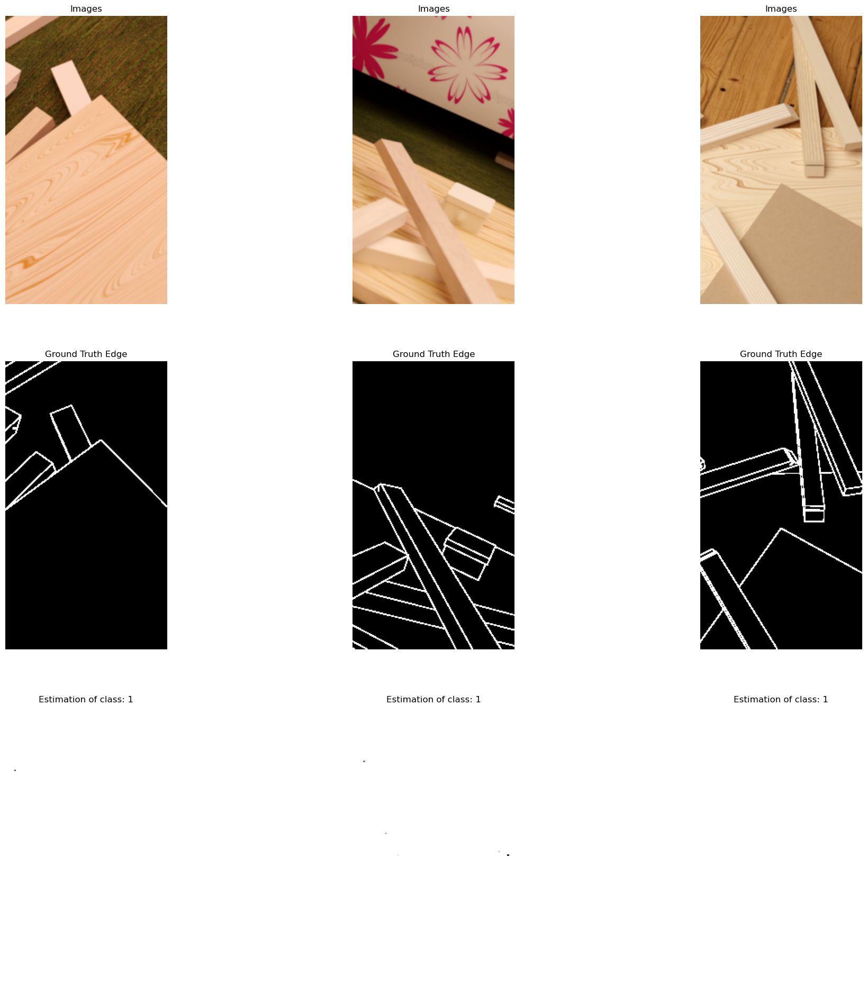

1/1 [==============================] - 0s 24ms/step


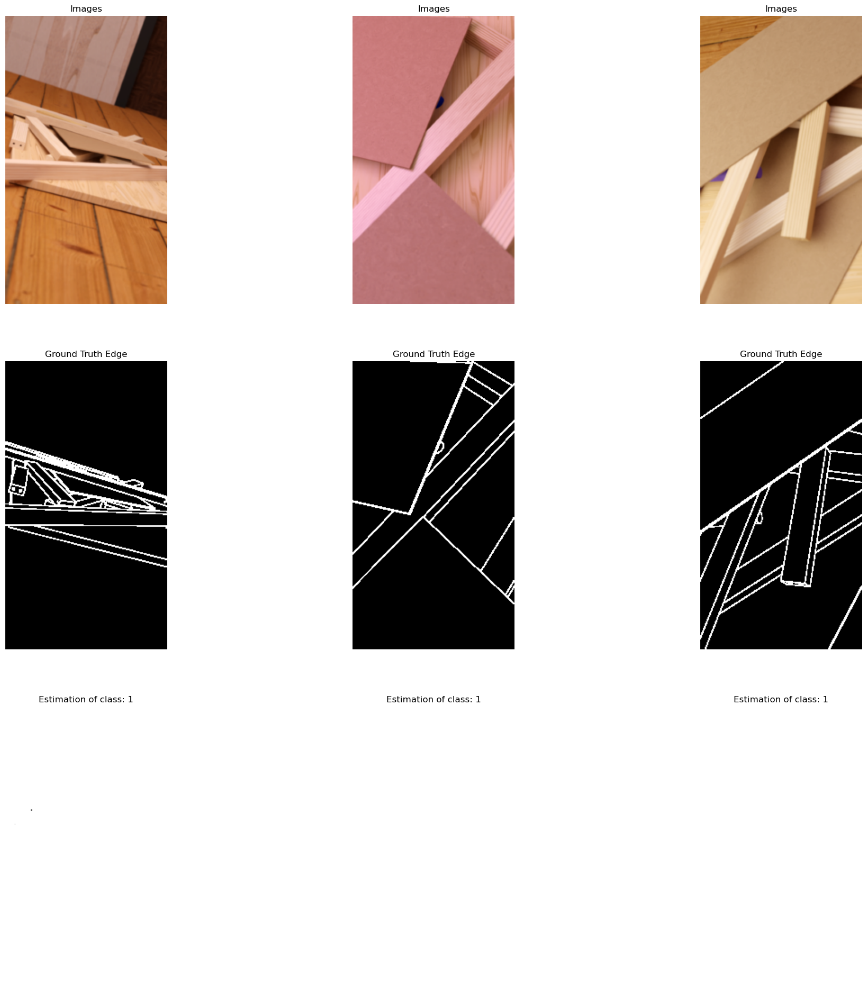

1/1 [==============================] - 0s 25ms/step


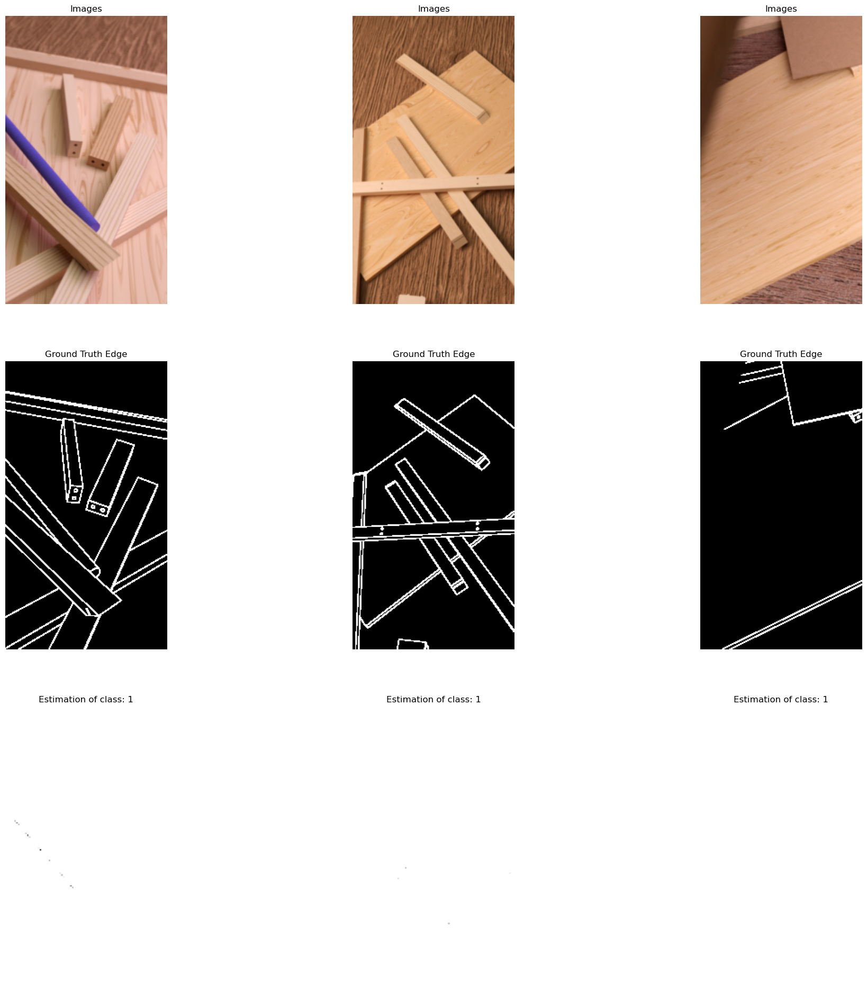

2023-02-05 00:54:32.081388: W tensorflow/core/kernels/data/cache_dataset_ops.cc:856] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


In [12]:
i = 0
for inp, out in test_ds.take(3):
    pred = model.predict(inp)
    path = os.path.join(Model.Data.paths["FIGURES"], "side_out_{}".format(i))
    edge_detection_plots.plot_edges(images=inp['in_img'],
                                    labels_edge=out['out_edge'],
                                    predictions_edge=pred[4],
                                    batch_size=DataProcessing.cfg['TEST']['BATCH_SIZE'],
                                   save=Model.cfg["SAVE"], path=path)
    i += 1

Max Accuracy Score = 0.986 at 0.400
MF1 = 0.899
MF1_1 = 0.899, ODS_1 = 0.400


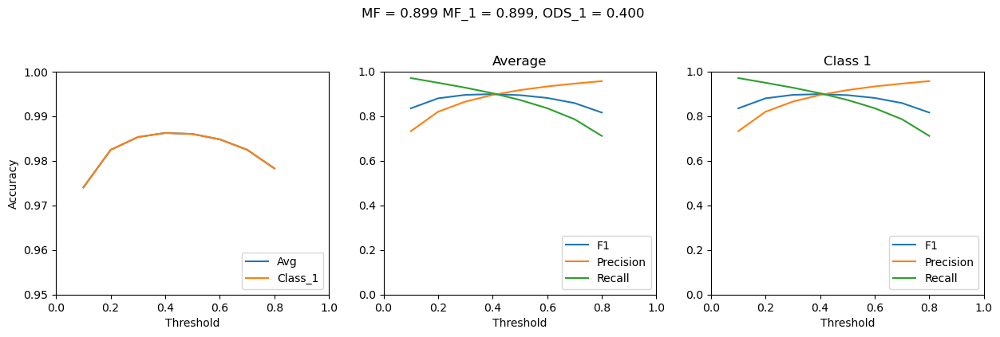

In [13]:
### Maximum F1 Score:
path = os.path.join(Model.Data.paths["FIGURES"], "threshold_metrics_evaluation_test_ds.svg")

Model.evaluate_and_plot_MF_score(model=model, dataset=test_ds, 
                                num_classes=DataProcessing.output_data_cfg["edge"]["num_classes"], path=path)

Max Accuracy Score = 0.971 at 0.800
MF1 = 0.698
MF1_1 = 0.698, ODS_1 = 0.800


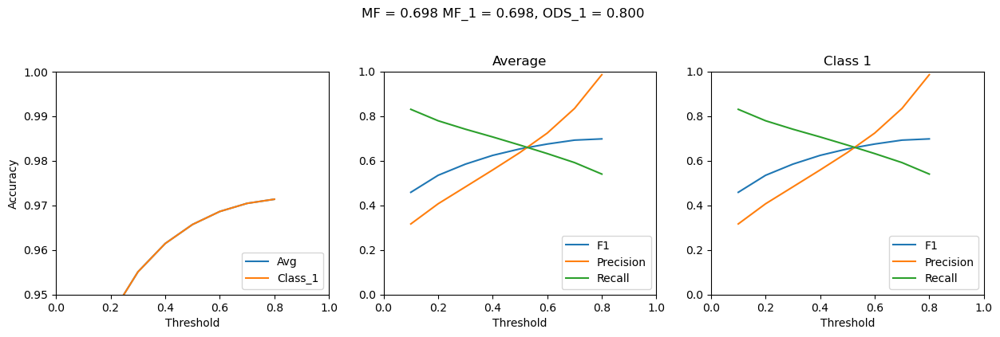

In [14]:
### Maximum F1 Score:
path = os.path.join(Model.Data.paths["FIGURES"],"threshold_metrics_evaluation_image_ds.svg")

Model.evaluate_and_plot_MF_score(model=model, dataset=real_world_ds, 
                                num_classes=DataProcessing.output_data_cfg["edge"]["num_classes"], 
                                path=path, threshold_edge_width=1.0)

In [15]:
if Model.cfg["CONVERT_TO_TFLITE"]:
    Model.convert_model_to_tflite(model)

INFO:tensorflow:Assets written to: /home/david/SemesterProject/Models/edge_detection/lenet/TFLITE/assets


INFO:tensorflow:Assets written to: /home/david/SemesterProject/Models/edge_detection/lenet/TFLITE/assets


=== TFLite ModelAnalyzer ===

Your TFLite model has '1' subgraph(s). In the subgraph description below,
T# represents the Tensor numbers. For example, in Subgraph#0, the DEQUANTIZE op takes
tensor #4 as input and produces tensor #95 as output.

Subgraph#0 main(T#0) -> [T#242, T#196, T#196, T#226, T#233]
  Op#0 DEQUANTIZE(T#4[]) -> [T#95]
  Op#1 DEQUANTIZE(T#5[]) -> [T#96]
  Op#2 DEQUANTIZE(T#6[]) -> [T#97]
  Op#3 DEQUANTIZE(T#7[]) -> [T#98]
  Op#4 DEQUANTIZE(T#8[]) -> [T#99]
  Op#5 DEQUANTIZE(T#9[]) -> [T#100]
  Op#6 DEQUANTIZE(T#10[]) -> [T#101]
  Op#7 DEQUANTIZE(T#11[]) -> [T#102]
  Op#8 DEQUANTIZE(T#12[]) -> [T#103]
  Op#9 DEQUANTIZE(T#13[]) -> [T#104]
  Op#10 DEQUANTIZE(T#14[]) -> [T#105]
  Op#11 DEQUANTIZE(T#15[]) -> [T#106]
  Op#12 DEQUANTIZE(T#16[]) -> [T#107]
  Op#13 DEQUANTIZE(T#17[]) -> [T#108]
  Op#14 DEQUANTIZE(T#18[]) -> [T#109]
  Op#15 DEQUANTIZE(T#19[]) -> [T#110]
  Op#16 DEQUANTIZE(T#20[]) -> [T#111]
  Op#17 DEQUANTIZE(T#21[]) -> [T#112]
  Op#18 DEQUANTIZE(T#22[]) -> [T

2023-02-05 00:55:03.784174: W tensorflow/compiler/mlir/lite/python/tf_tfl_flatbuffer_helpers.cc:362] Ignored output_format.
2023-02-05 00:55:03.784204: W tensorflow/compiler/mlir/lite/python/tf_tfl_flatbuffer_helpers.cc:365] Ignored drop_control_dependency.
2023-02-05 00:55:03.784737: I tensorflow/cc/saved_model/reader.cc:45] Reading SavedModel from: /home/david/SemesterProject/Models/edge_detection/lenet/TFLITE
2023-02-05 00:55:03.796406: I tensorflow/cc/saved_model/reader.cc:89] Reading meta graph with tags { serve }
2023-02-05 00:55:03.796434: I tensorflow/cc/saved_model/reader.cc:130] Reading SavedModel debug info (if present) from: /home/david/SemesterProject/Models/edge_detection/lenet/TFLITE
2023-02-05 00:55:03.827530: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:354] MLIR V1 optimization pass is not enabled
2023-02-05 00:55:03.841719: I tensorflow/cc/saved_model/loader.cc:229] Restoring SavedModel bundle.
2023-02-05 00:55:04.072053: I tensorflow/cc/saved_model/loa